# Annotations using clustering for cells for heart_s0

In [1]:
slide_id = "heart_s0"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_heart_s0.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 10645, 24544), (3, 5323, 12272)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 10) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (26366, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (26366, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (26366, 377)
      └── 'table_nuclei': AnnData (26366, 541)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 26366 × 377
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region
0,aaaaaaaa-1,67,0,0,0,0,67,412.908765,14.043594,cell_labels
1,aaaaaaab-1,84,0,0,0,0,84,552.622208,10.024688,cell_labels
2,aaaaaaac-1,44,0,0,1,0,45,284.348917,10.927813,cell_labels
3,aaaaaaad-1,98,0,0,0,0,98,537.043301,36.712033,cell_labels
4,aaaaaaae-1,73,0,0,0,0,73,487.552049,40.685783,cell_labels
...,...,...,...,...,...,...,...,...,...,...
26361,aaaaggpj-1,46,0,0,0,0,46,192.275319,45.562658,cell_labels
26362,aaaaggpk-1,130,0,0,0,0,130,746.252215,69.224534,cell_labels
26363,aaaaggpl-1,65,0,0,0,0,65,362.333763,33.957501,cell_labels
26364,aaaaggpm-1,88,0,0,0,0,88,447.227516,27.545313,cell_labels


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
ABCC11,ENSG00000121270,Gene Expression,Unknown
ACE2,ENSG00000130234,Gene Expression,Unknown
ACKR1,ENSG00000213088,Gene Expression,Unknown
ACTA2,ENSG00000107796,Gene Expression,Unknown
ACTG2,ENSG00000163017,Gene Expression,Unknown
...,...,...,...
UPK3B,ENSG00000243566,Gene Expression,Unknown
VCAN,ENSG00000038427,Gene Expression,Unknown
VSIG4,ENSG00000155659,Gene Expression,Unknown
VWA5A,ENSG00000110002,Gene Expression,Unknown


In [7]:
adata_nuclei = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 13411 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'log1p', 'pca', 'pca_n10_pcs16', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.2_colors', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.4_colors', 'pca_n10_pcs16_leiden_res0.6', 'pca_n10_pcs16_leiden_res0.6_colors', 'rank_genes_pca_n10_pcs16_leiden_res0.2', 'rank_genes_pca_n10_pcs16_leiden_res0.4', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n10_pcs16_connectivities', 'pca_n10_pcs16_distances'

In [8]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,35.131678,Endocardial cell,22,0,0,7,0,Cardiomyocyte,Cardiomyocyte,normal_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,38.134416,Neuron,20,0,0,0,0,Cardiomyocyte,Cardiomyocyte,normal_cell
aaaaaaaf-1,nucleus_boundaries,morpho,aaaaaaaf-1,10.385908,Capillary EC,12,1,1,1,1,Endothelial,Endothelial,normal_cell
aaaaaaag-1,nucleus_boundaries,morpho,aaaaaaag-1,29.757835,Ventricular cardiomyocyte,25,0,0,0,0,Cardiomyocyte,Cardiomyocyte,normal_cell
aaaaaaah-1,nucleus_boundaries,morpho,aaaaaaah-1,10.295643,T cell,13,5,5,9,5,T/NK,T/NK,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaaaggpg-1,nucleus_boundaries,morpho,aaaaggpg-1,15.172433,PCOLCE2 fibroblast,16,2,2,2,2,Fibroblast,Fibroblast,normal_cell
aaaaggpi-1,nucleus_boundaries,morpho,aaaaggpi-1,31.383749,Capillary EC,15,1,1,1,1,Endothelial,Endothelial,normal_cell
aaaaggpj-1,nucleus_boundaries,morpho,aaaaggpj-1,42.628748,NK cell,24,0,0,0,0,Cardiomyocyte,Cardiomyocyte,normal_cell
aaaaggpk-1,nucleus_boundaries,morpho,aaaaggpk-1,65.838842,Ventricular cardiomyocyte,49,0,0,0,0,Cardiomyocyte,Cardiomyocyte,normal_cell


In [9]:
adata_nuclei.var

,mean,std
ABCC11,0.015360,0.301491
ACE2,0.178880,1.030948
ACKR1,0.151065,0.948212
ACTA2,0.503987,1.752786
ACTG2,0.615004,1.837248
...,...,...
UnassignedCodeword_0499,0.001868,0.108324
VCAN,0.333999,1.411425
VSIG4,0.148880,0.950924
VWA5A,0.107141,0.802084


## 2. Preprocessing

<Axes: >

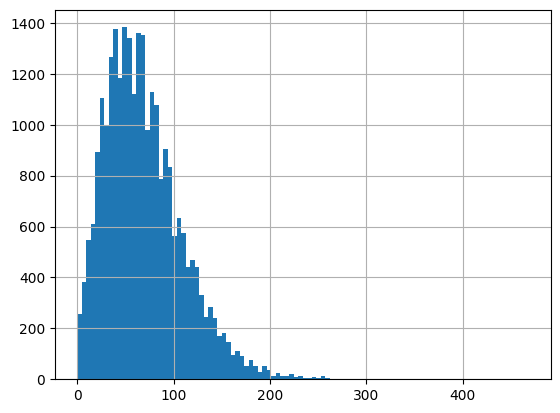

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

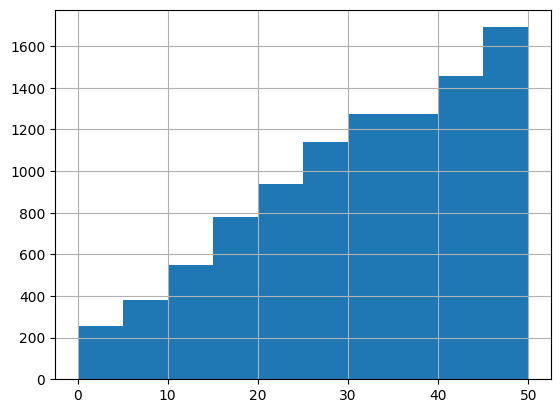

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 1967
Percentage of cells with less than 20 transcripts: 7.46%
-----
Number of cells with less than 15 transcripts: 1187
Percentage of cells with less than 15 transcripts: 4.5%
-----
Number of cells with less than 10 transcripts: 640
Percentage of cells with less than 10 transcripts: 2.43%
-----
Number total of cells: 26366


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

25611


In [14]:
# Save the raw data
adata_cells.layers['count'] = adata_cells.X.copy()

In [15]:
# Normalize
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [16]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [17]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


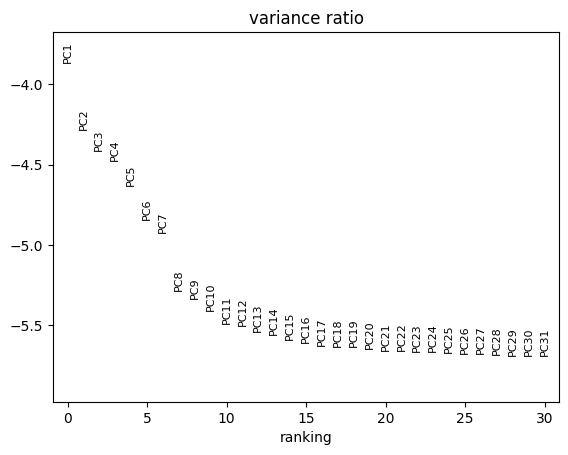

In [18]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [19]:
adata_cells

AnnData object with n_obs × n_vars = 25611 × 377
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [20]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [21]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata_cells, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata_cells, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_3859/1436083260.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


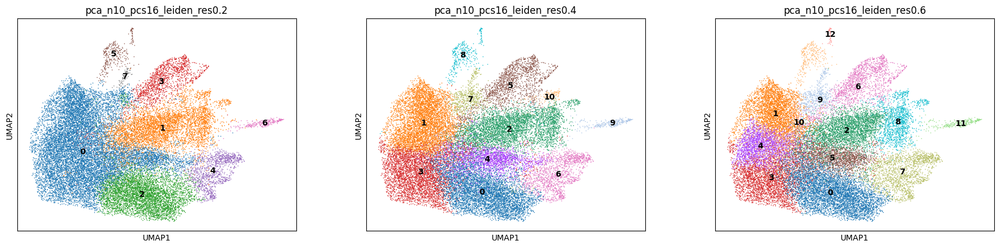

In [22]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16',
           color=['pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

In [23]:
# Number of clusters
adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].unique()

['0', '1', '3', '5', '2', ..., '4', '7', '6', '10', '9']
Length: 11
Categories (11, object): ['0', '1', '2', '3', ..., '7', '8', '9', '10']

In [26]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['8']), 'refine_res'] = '8'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['9']), 'refine_res'] = '9'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['10']), 'refine_res'] = '10'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['8']), 'refine_res'] = '11'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['10']), 'refine_res'] = '10'

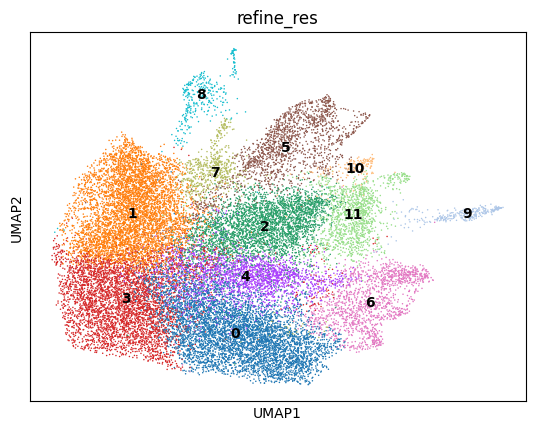

In [27]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [28]:
clustering_label = 'refine_res'

In [29]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

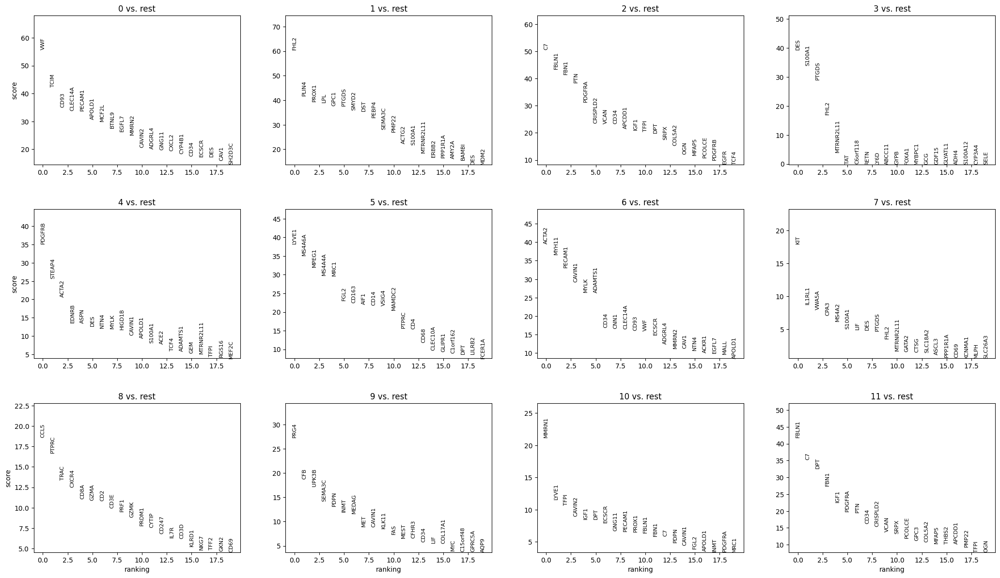

In [30]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [31]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [32]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [33]:
cluster_id = '0'

In [34]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endothelial,Endothelial,normal_cell,50.1
1,NA,NA,NA,41.5
2,Cardiomyocyte,Cardiomyocyte,normal_cell,5.1
3,Perivascular,Smooth_muscle_and_pericyte,normal_cell,1.6
4,Fibroblast,Fibroblast,normal_cell,1.5


In [35]:
top_ranked_genes[cluster_id]

0        VWF
1       TCIM
2       CD93
3    CLEC14A
4     PECAM1
5     APOLD1
6      MCF2L
Name: 0, dtype: object

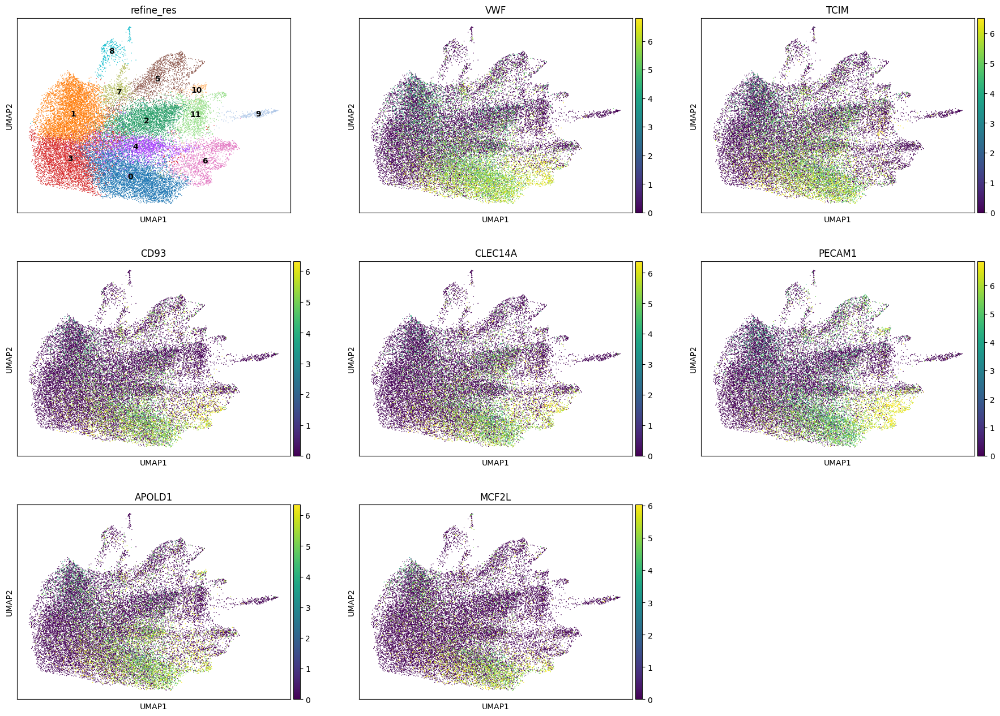

In [36]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [37]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 5339
Percentage of cells in cluster 0: 20.8


In [38]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.2. Cluster 1

In [39]:
cluster_id = '1'

In [40]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Cardiomyocyte,Cardiomyocyte,normal_cell,68.3
1,NA,NA,NA,25.8
2,Fibroblast,Fibroblast,normal_cell,2.6
3,Endothelial,Endothelial,normal_cell,1.6
4,Perivascular,Smooth_muscle_and_pericyte,normal_cell,1.3


In [41]:
top_ranked_genes[cluster_id]

0     FHL2
1    PLIN4
2    PROX1
3      LPL
4     GPC1
5    PTGDS
6    SMYD2
Name: 1, dtype: object

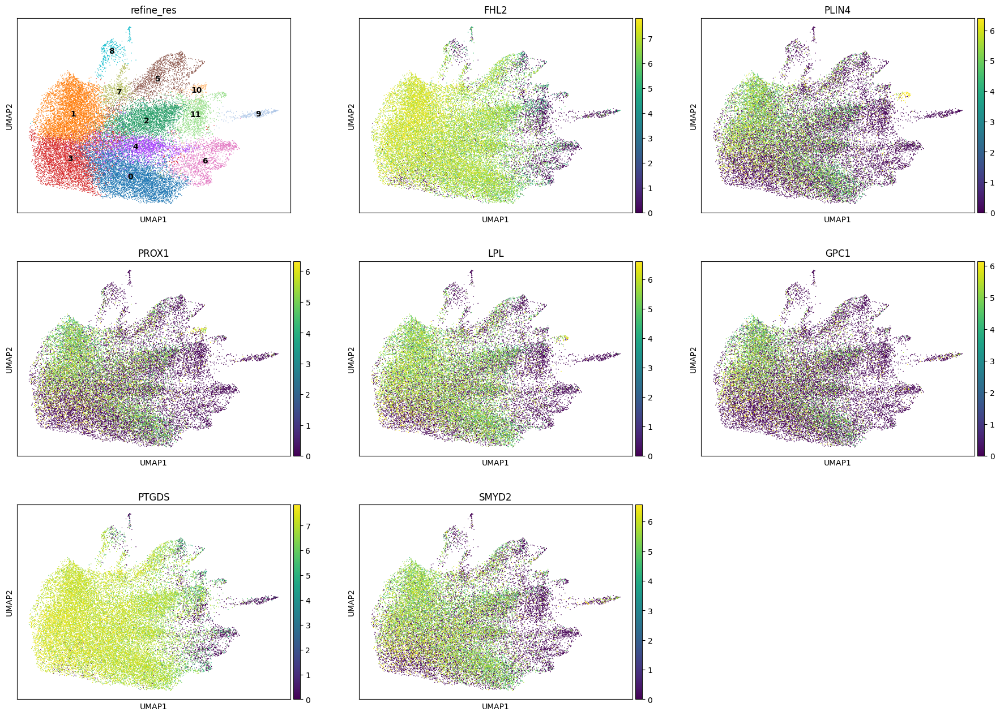

In [42]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [43]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 5070
Percentage of cells in cluster 1: 19.8


In [44]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Cardiomyocyte'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Cardiomyocyte'

### 5.3. Cluster 2

In [45]:
cluster_id = '2'

In [46]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast,Fibroblast,normal_cell,44.5
1,NA,NA,NA,43.2
2,Cardiomyocyte,Cardiomyocyte,normal_cell,5.4
3,Endothelial,Endothelial,normal_cell,3.4
4,Perivascular,Smooth_muscle_and_pericyte,normal_cell,2.8


In [47]:
top_ranked_genes[cluster_id]

0          C7
1       FBLN1
2        FBN1
3         PTN
4      PDGFRA
5    CRISPLD2
6        VCAN
Name: 2, dtype: object

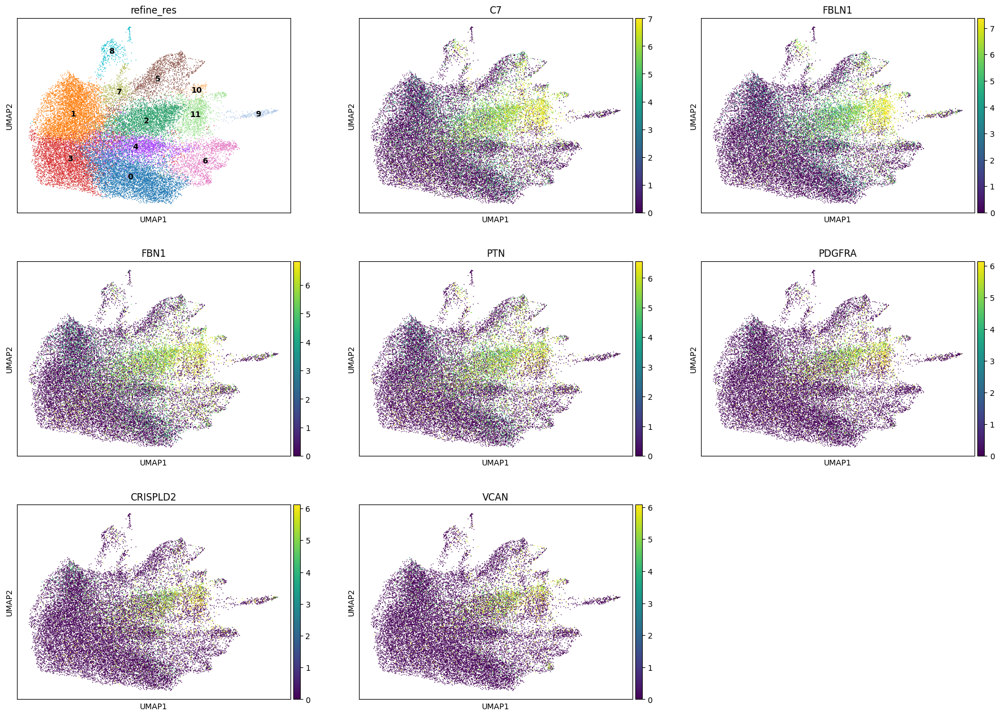

In [48]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [49]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 3159
Percentage of cells in cluster 2: 12.3


In [50]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast'

### 5.4. Cluster 3

In [51]:
cluster_id = '3'

In [52]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,87.6
1,Cardiomyocyte,Cardiomyocyte,normal_cell,7.9
2,Endothelial,Endothelial,normal_cell,2.4
3,Fibroblast,Fibroblast,normal_cell,1.2
4,Perivascular,Smooth_muscle_and_pericyte,normal_cell,0.7


In [53]:
top_ranked_genes[cluster_id]

0          DES
1       S100A1
2        PTGDS
3         FHL2
4    MTRNR2L11
5          TAT
6     C6orf118
Name: 3, dtype: object

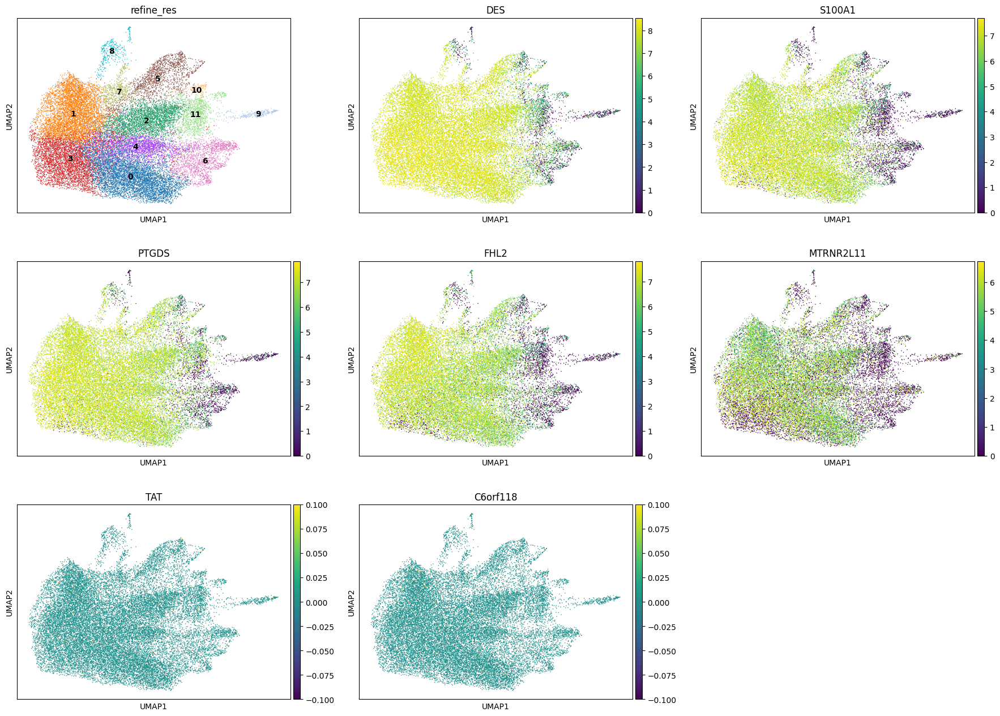

In [54]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [55]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 4171
Percentage of cells in cluster 3: 16.3


In [56]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Cardiomyocyte'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Cardiomyocyte'

### 5.5. Cluster 4

In [57]:
cluster_id = '4'

In [58]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,51.6
1,Perivascular,Smooth_muscle_and_pericyte,normal_cell,33.5
2,Cardiomyocyte,Cardiomyocyte,normal_cell,4.5
3,Endothelial,Endothelial,normal_cell,4.0
4,Fibroblast,Fibroblast,normal_cell,3.2


In [59]:
top_ranked_genes[cluster_id]

0    PDGFRB
1    STEAP4
2     ACTA2
3     EDNRB
4      ASPN
5       DES
6      NTN4
Name: 4, dtype: object

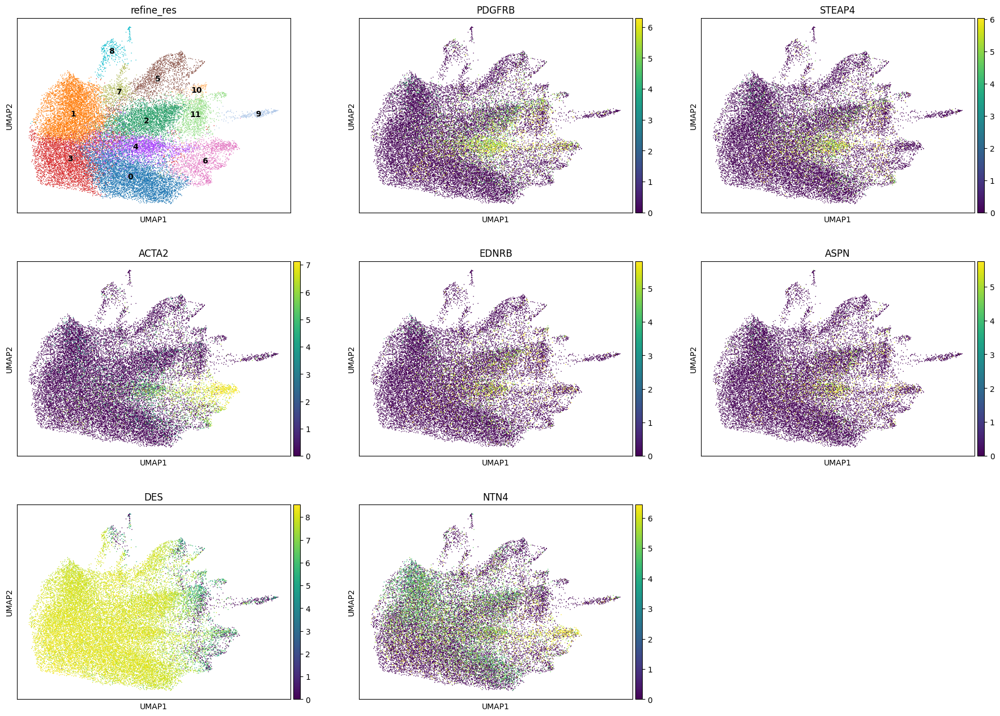

In [60]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [61]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 2160
Percentage of cells in cluster 4: 8.4


In [62]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Smooth_muscle'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Smooth_muscle'

### 5.6. Cluster 5

In [63]:
cluster_id = '5'

In [64]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,44.8
1,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,39.6
2,Fibroblast,Fibroblast,normal_cell,7.3
3,Cardiomyocyte,Cardiomyocyte,normal_cell,3.3
4,Endothelial,Endothelial,normal_cell,3.2


In [65]:
top_ranked_genes[cluster_id]

0     LYVE1
1    MS4A6A
2     MPEG1
3    MS4A4A
4      MRC1
5      FGL2
6     CD163
Name: 5, dtype: object

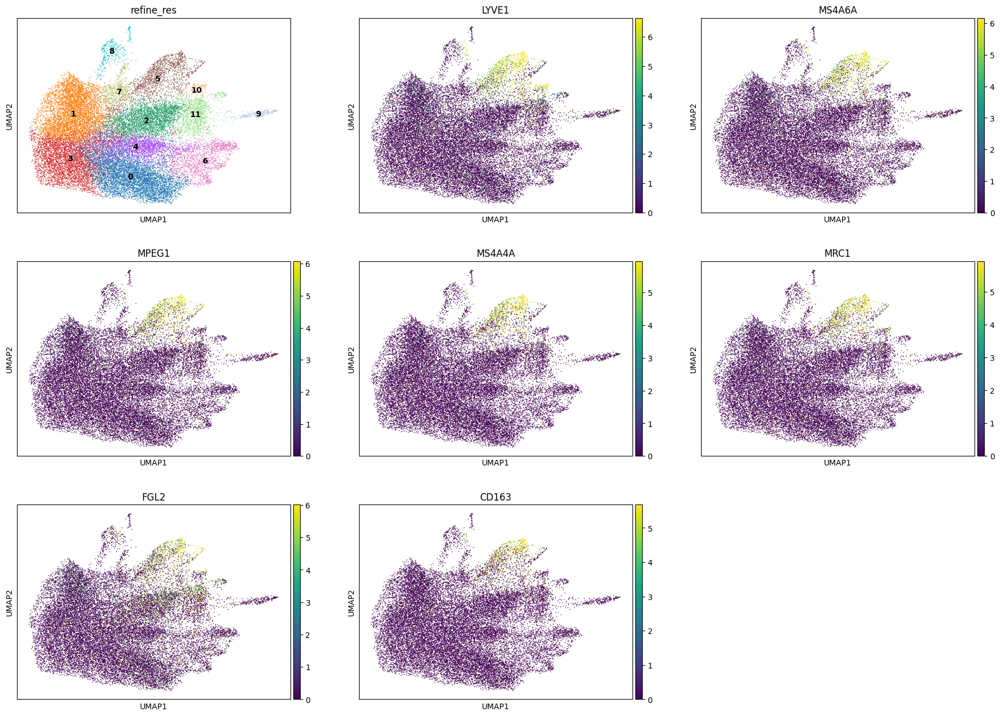

In [66]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [67]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 1590
Percentage of cells in cluster 5: 6.2


In [68]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.7. Cluster 6

In [69]:
cluster_id = '6'

In [70]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,40.9
1,Endothelial,Endothelial,normal_cell,34.1
2,Perivascular,Smooth_muscle,normal_cell,18.1
3,Perivascular,Smooth_muscle_and_pericyte,normal_cell,5.6
4,Fibroblast,Fibroblast,normal_cell,1.0


In [71]:
top_ranked_genes[cluster_id]

0      ACTA2
1      MYH11
2     PECAM1
3     CAVIN1
4       MYLK
5    ADAMTS1
6       CD34
Name: 6, dtype: object

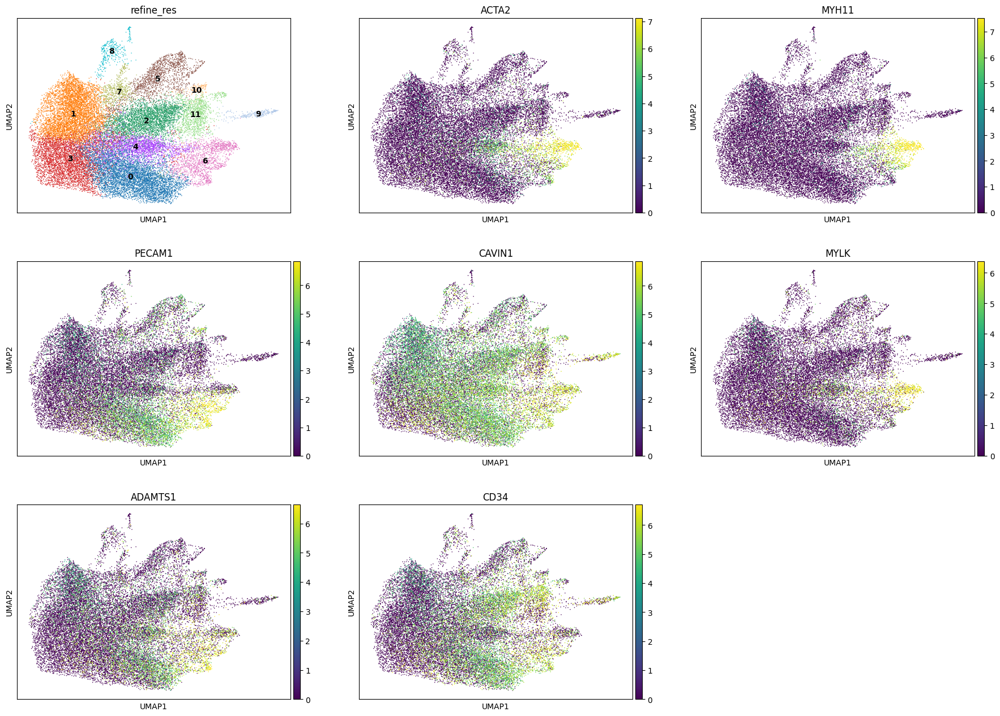

In [72]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [73]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 1432
Percentage of cells in cluster 6: 5.6


In [74]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Blood_vessel'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial_Smooth_muscle'

### 5.8. Cluster 7

In [75]:
cluster_id = '7'

In [76]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,51.6
1,Cardiomyocyte,Cardiomyocyte,normal_cell,20.4
2,Endothelial,Endothelial,normal_cell,12.9
3,Mast,Mast,normal_cell,5.9
4,Perivascular,Smooth_muscle_and_pericyte,normal_cell,4.5


In [77]:
top_ranked_genes[cluster_id]

0       KIT
1    IL1RL1
2     VWA5A
3      CPA3
4     MS4A2
5    S100A1
6       LIF
Name: 7, dtype: object

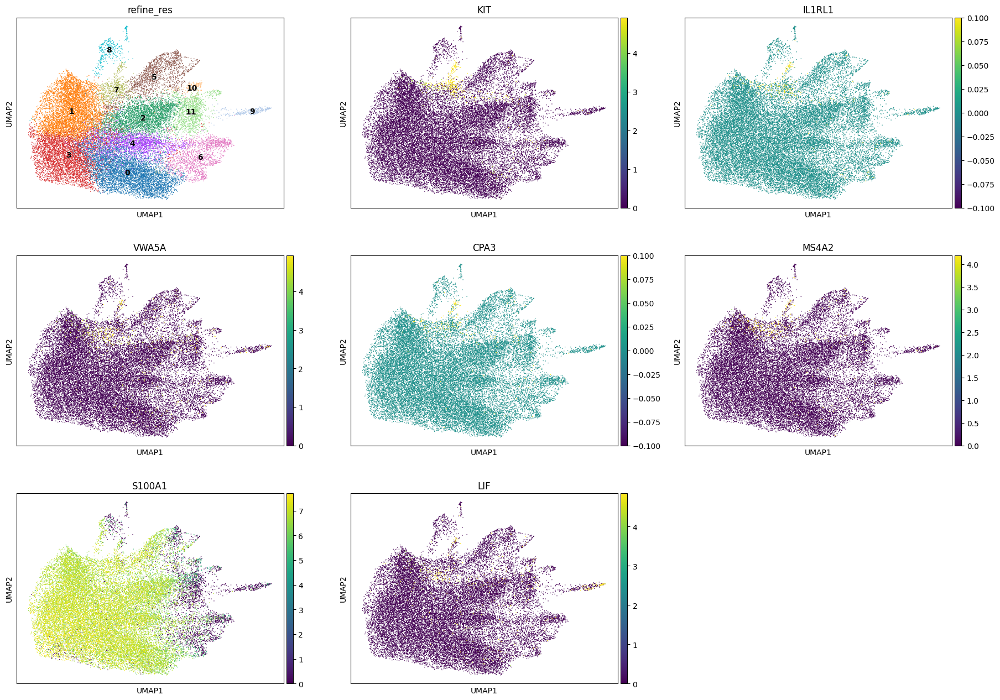

In [78]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [79]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 642
Percentage of cells in cluster 7: 2.5


In [80]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Mast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Mast'

### 5.9. Cluster 8

In [81]:
cluster_id = '8'

In [82]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T/NK,T/NK,normal_cell,53.8
1,NA,NA,NA,31.8
2,ToRemove,ToRemove,normal_cell,9.1
3,Fibroblast,Fibroblast,normal_cell,1.8
4,Endothelial,Endothelial,normal_cell,1.5


In [83]:
top_ranked_genes[cluster_id]

0     CCL5
1    PTPRC
2     TRAC
3    CXCR4
4     CD8A
5     GZMA
6      CD2
Name: 8, dtype: object

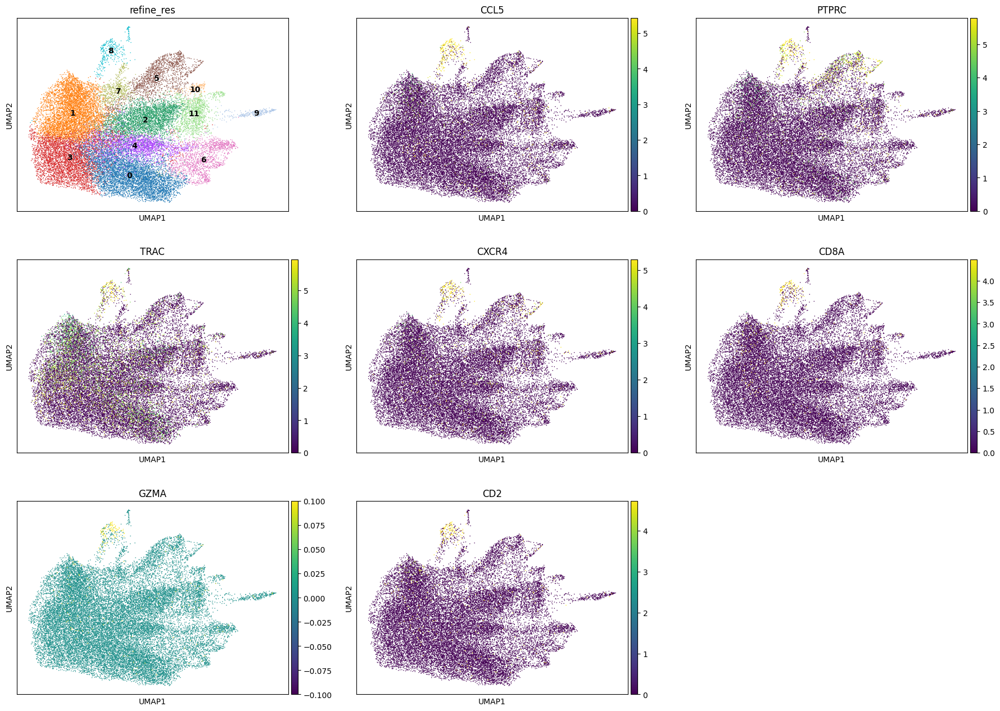

In [84]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [85]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 340
Percentage of cells in cluster 8: 1.3


In [86]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T_CD8'

### 5.10. Cluster 9

In [87]:
cluster_id = '9'

In [88]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,49.5
1,Valvular_interstitial_cell,Valvular_interstitial_cell,normal_cell,44.0
2,Fibroblast,Fibroblast,normal_cell,2.2
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,1.8
4,Cardiomyocyte,Cardiomyocyte,normal_cell,1.5


In [89]:
top_ranked_genes[cluster_id]

0      PRG4
1       CFB
2     UPK3B
3    SEMA3C
4      PDPN
5      INMT
6     MEDAG
Name: 9, dtype: object

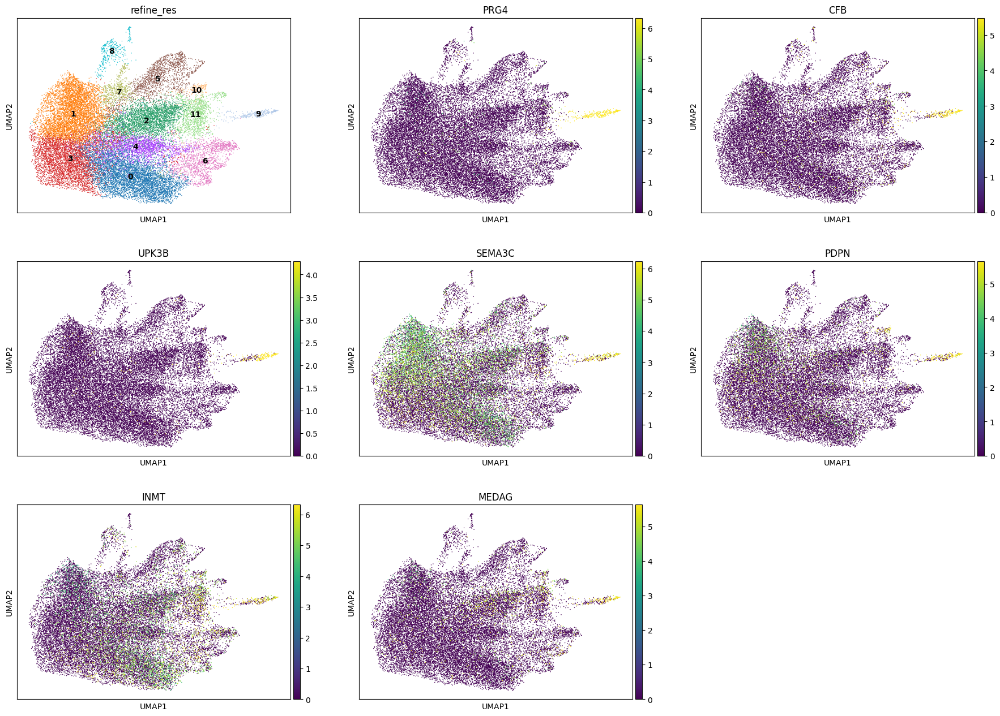

In [90]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [91]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 275
Percentage of cells in cluster 9: 1.1


In [92]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Valvular_interstitial_cell'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Valvular_interstitial_cell'

### 5.11. Cluster 10

In [93]:
cluster_id = '10'

In [94]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,36.4
1,Valvular_interstitial_cell,Valvular_interstitial_cell,normal_cell,24.3
2,Fibroblast,Fibroblast,normal_cell,20.8
3,Endothelial,Endothelial,normal_cell,8.7
4,Cardiomyocyte,Cardiomyocyte,normal_cell,6.4


In [95]:
top_ranked_genes[cluster_id]

0     MMRN1
1     LYVE1
2      TFPI
3    CAVIN2
4      IGF1
5       DPT
6     ECSCR
Name: 10, dtype: object

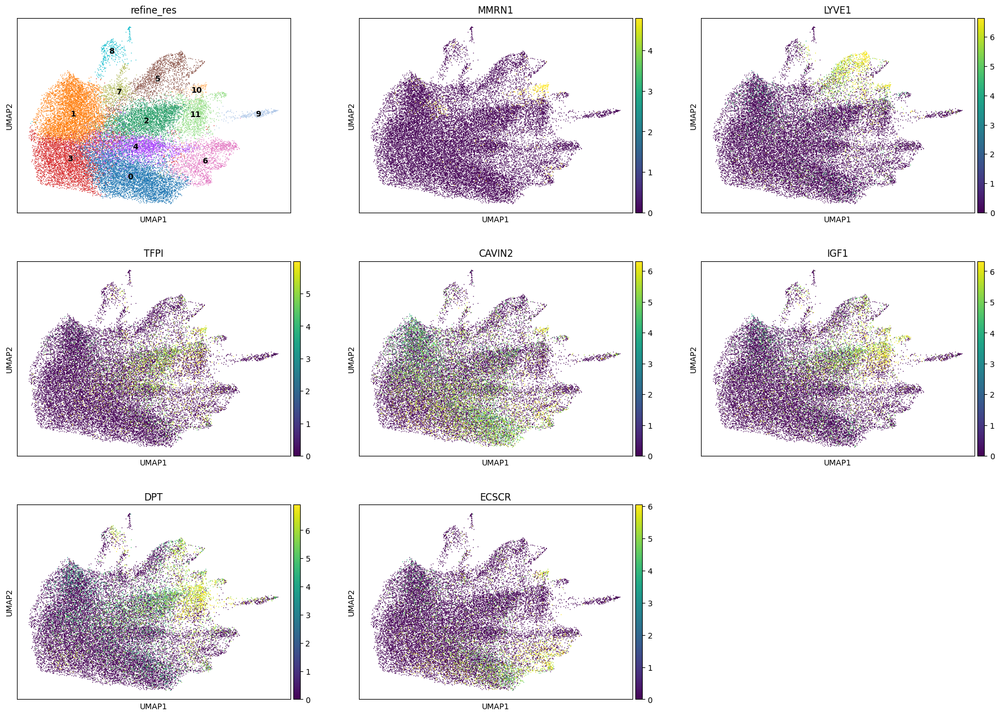

In [97]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [98]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 173
Percentage of cells in cluster 10: 0.7


In [99]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.12. Cluster 11

In [100]:
cluster_id = '11'

In [101]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,48.3
1,Fibroblast,Fibroblast,normal_cell,43.7
2,Cardiomyocyte,Cardiomyocyte,normal_cell,2.4
3,Perivascular,Smooth_muscle_and_pericyte,normal_cell,2.1
4,Endothelial,Endothelial,normal_cell,1.3


In [102]:
top_ranked_genes[cluster_id]

0     FBLN1
1        C7
2       DPT
3      FBN1
4      IGF1
5    PDGFRA
6       PTN
Name: 11, dtype: object

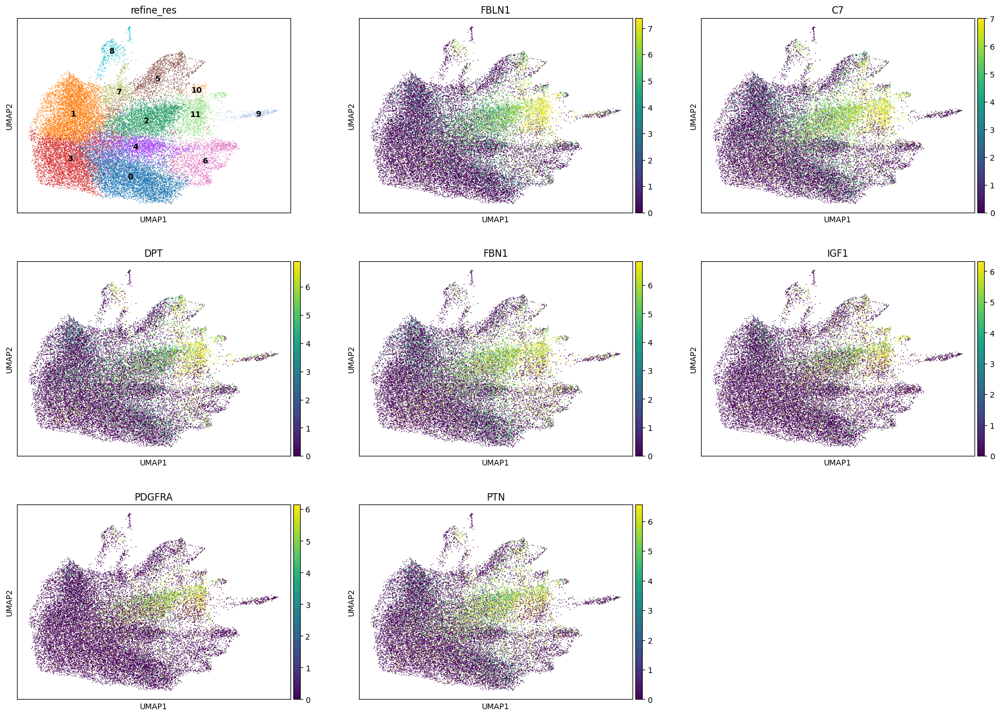

In [104]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [105]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 1260
Percentage of cells in cluster 11: 4.9


In [106]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast'

## 6. Cancer cells

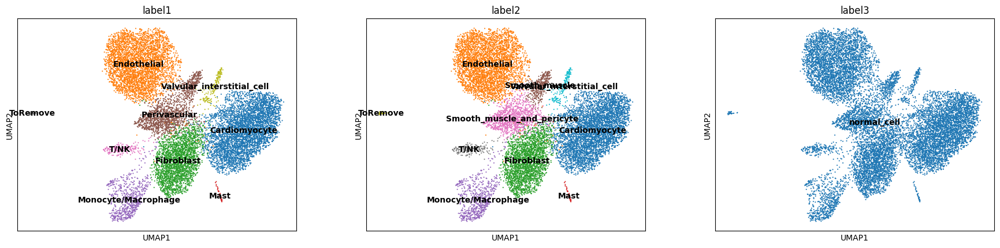

In [109]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

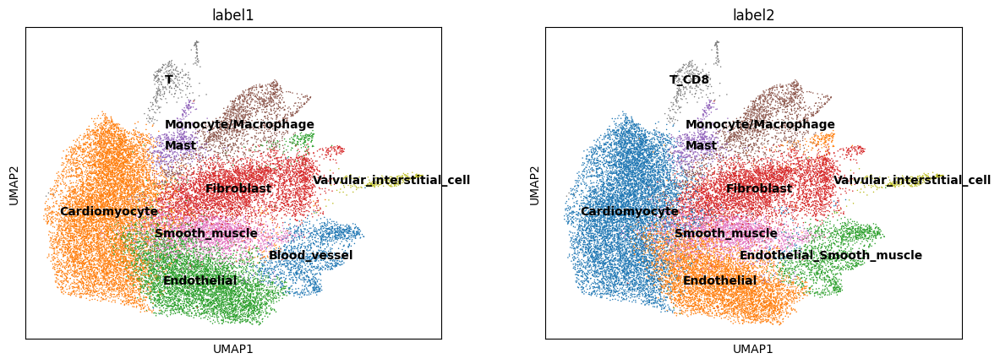

In [110]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [111]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'

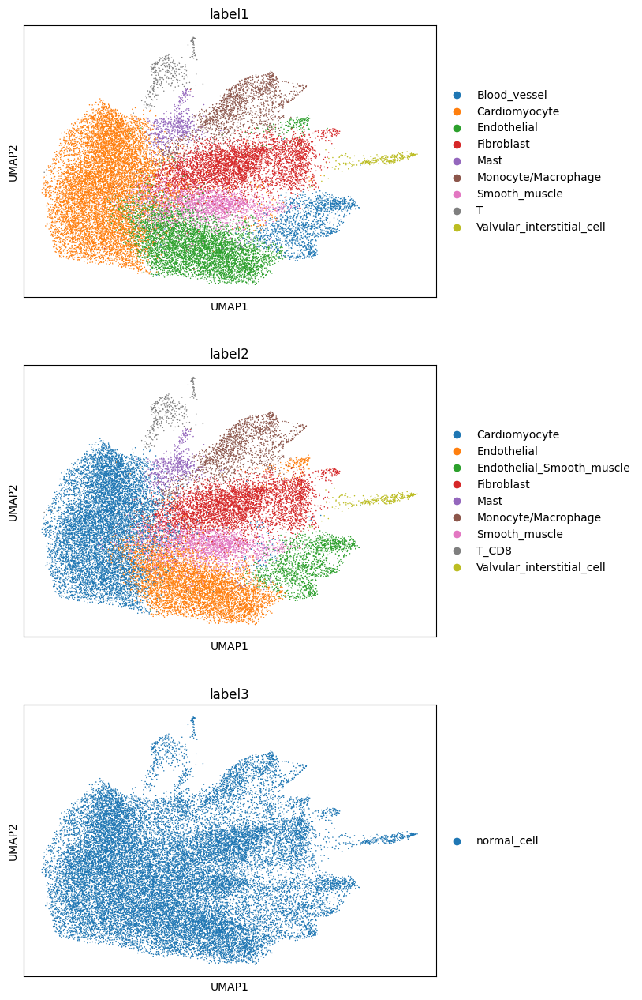

In [112]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [113]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
0,aaaaaaaa-1,67,0,0,0,0,67,412.908765,14.043594,cell_labels,2,0,0,0,Endothelial,Endothelial,normal_cell
1,aaaaaaab-1,84,0,0,0,0,84,552.622208,10.024688,cell_labels,0,1,4,1,Cardiomyocyte,Cardiomyocyte,normal_cell
2,aaaaaaac-1,44,0,0,1,0,45,284.348917,10.927813,cell_labels,0,3,3,3,Cardiomyocyte,Cardiomyocyte,normal_cell
3,aaaaaaad-1,98,0,0,0,0,98,537.043301,36.712033,cell_labels,3,5,6,5,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
4,aaaaaaae-1,73,0,0,0,0,73,487.552049,40.685783,cell_labels,1,2,2,2,Fibroblast,Fibroblast,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26361,aaaaggpj-1,46,0,0,0,0,46,192.275319,45.562658,cell_labels,0,1,1,1,Cardiomyocyte,Cardiomyocyte,normal_cell
26362,aaaaggpk-1,130,0,0,0,0,130,746.252215,69.224534,cell_labels,0,1,1,1,Cardiomyocyte,Cardiomyocyte,normal_cell
26363,aaaaggpl-1,65,0,0,0,0,65,362.333763,33.957501,cell_labels,1,2,2,2,Fibroblast,Fibroblast,normal_cell
26364,aaaaggpm-1,88,0,0,0,0,88,447.227516,27.545313,cell_labels,2,0,0,0,Endothelial,Endothelial,normal_cell


In [114]:
adata_cells.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")